In [2]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import plotly
import plotly.express as px

from sklearn.preprocessing import KBinsDiscretizer
from sklearn.metrics import confusion_matrix
import datetime
from sklearn.metrics import mean_absolute_error, f1_score

from lifetimes import BetaGeoFitter, GammaGammaFitter
from lifetimes.utils import calibration_and_holdout_data, summary_data_from_transaction_data

##### To see all interactive visualizations, look at the HTML version of ths notebook in the **htmls** folder!
###### Best results have been observed by opening the html file in Chrome

In [3]:
plotly.offline.init_notebook_mode()

In [4]:
#Import data
transactionsdf = pd.read_csv('data/transactions_filtered.csv.gz', compression='gzip', parse_dates=['date'])

### **Data Preprocessing**

In [5]:
#We want 1 year of data
#The data should not have any refunds
transactionsdf_year = transactionsdf.loc[(transactionsdf.date <= '2013-03-02') & (transactionsdf.purchaseamount > 0), ['id', 'date', 'purchasequantity', 'purchaseamount']]
transactionsdf_year

,id,date,purchasequantity,purchaseamount
0,86246,2012-03-02,1,1.00
1,86246,2012-03-06,1,4.99
2,86246,2012-03-09,1,8.99
3,86246,2012-03-11,2,2.00
4,86246,2012-03-19,1,1.99
...,...,...,...,...
5642722,4797277036,2012-08-04,1,9.49
5642723,4797277036,2012-10-01,1,2.50
5642724,4797277036,2012-12-27,1,15.49
5642725,4797277036,2012-12-27,2,6.98


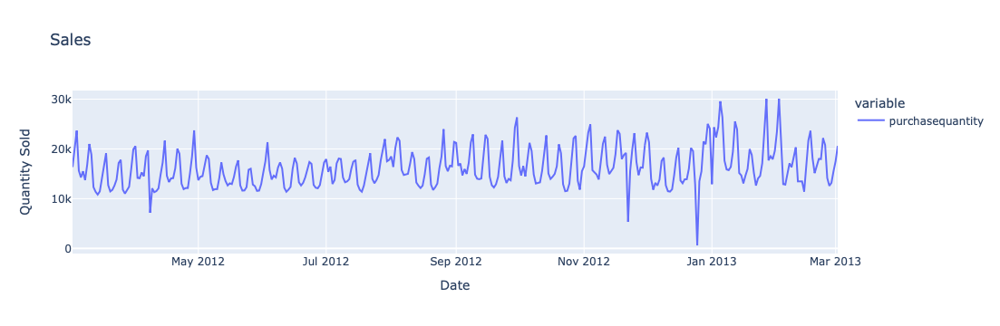

In [6]:
salesdf = transactionsdf_year.groupby('date')['purchasequantity'].sum()
fig = px.line(salesdf, title='Sales')
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Quantity Sold'
)
fig.show()


In [7]:
print(f'Unique Customers: {transactionsdf_year.id.nunique()}')
print(f'Unique Days: {transactionsdf_year.date.nunique()}')

Unique Customers: 284684
Unique Days: 366


##### The goal of this project is to model the customer lifetime value. Out of the 17,3025 customers, we can assume some customers will have several purchases within the company and others will have churned.

In [8]:
transactionsdf_year.id.value_counts().describe()

count    284684.000000
mean         16.478706
std         137.795616
min           1.000000
25%           4.000000
50%          10.000000
75%          20.000000
max       46673.000000
Name: count, dtype: float64

##### **Insights**: Some customers have made only 1 purchase, while others have made tens of thousands. 50% of customers made 10 or more purchases. 
##### Which customers are more likely to continue making purchases at this imaginary company?
##### To answer this, we will try to fit a BG/NBD (Beta Gamma/Negative Binomial Distribution) model. Refer to README file for background on this model.

### **Modeling and Evaluation**
##### Outlined below is the method I will use to model and evaluate CLV:
##### &emsp;1. Split data into train/test
##### &emsp;2. Fit and evaluate BG/NBD model for purchase frequency prediction
##### &emsp;3. Fit and evaluate Gamma-Gamma model for monetary value prediction
##### &emsp;4. Combine 2 models into the final CLV model and compare to a baseline (naive) approach
##### &emsp;5. Refit the model on the entire dataset

##### **1. Train/Test Split**
##### We can utilize the ```calibration_and_holdout_data``` function to split the data for us

In [9]:
rfm_train_test = calibration_and_holdout_data(transactionsdf_year, 'id', 'date',
                                              calibration_period_end='2012-11-01',
                                              observation_period_end='2013-03-02',
                                              monetary_value_col = 'purchaseamount')

In [10]:
rfm_train_test.head()

,frequency_cal,recency_cal,T_cal,monetary_value_cal,frequency_holdout,monetary_value_holdout,duration_holdout
id,,,,,,,
86246,42.0,239.0,244.0,5.046667,18.0,4.626316,121.0
86252,34.0,232.0,244.0,5.143235,14.0,6.284706,121.0
12262064,4.0,178.0,210.0,2.940000,2.0,4.145000,121.0
12277270,13.0,228.0,228.0,6.062308,7.0,8.570000,121.0
12332190,5.0,204.0,211.0,5.148000,4.0,4.990000,121.0


##### We should filter out customers who have not made more than 1 purchase, because we cannot make a prediction for them. Their frequency will be 0 in the dataset.

In [11]:
rfm_train_test = rfm_train_test.loc[rfm_train_test.frequency_cal > 0, :]

##### **2. BG/NBD Model**
##### Fit model and make prediction.

In [12]:
bgf = BetaGeoFitter(penalizer_coef=0.0)
bgf.fit(rfm_train_test['frequency_cal'], rfm_train_test['recency_cal'], rfm_train_test['T_cal'])

<lifetimes.BetaGeoFitter: fitted with 226726 subjects, a: 12.09, alpha: 65.37, b: 258222.03, r: 2.35>

In [13]:
bgf_preds = bgf.predict((datetime.datetime(2013, 3, 2) - datetime.datetime(2012, 11, 1)).days,
                        rfm_train_test['frequency_cal'],
                        rfm_train_test['recency_cal'],
                        rfm_train_test['T_cal'])

##### Evaluate model.

In [14]:
actual = rfm_train_test['frequency_holdout']
preds = bgf_preds
def evaluate_model(actual, preds, bins):
    print(f'Mean absolute error: {mean_absolute_error(actual, preds)}')
    fig = px.scatter(x=np.array(preds), y=np.array(actual), title='Predicted vs Actual')
    fig.update_layout(
        xaxis_title='Predicted',
        yaxis_title='Actual'
    )
    fig.show()
    # plt.figure(figsize=(10, 7))
    # plt.scatter(preds, actual)
    # plt.xlabel('Predicted')
    # plt.ylabel('Actual')
    # plt.title('Predicted vs Actual')
    # plt.show()
    
    #Evaluate Bins
    est = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='kmeans')
    est.fit(np.array(actual).reshape(-1, 1))
    actual_bin = est.transform(np.array(actual).reshape(-1, 1)).ravel()
    preds_bin = est.transform(np.array(preds).reshape(-1, 1)).ravel()
    
    cm = confusion_matrix(actual_bin, preds_bin, normalize='true')
    df_cm = pd.DataFrame(cm, index = range(1, bins+1),
                      columns = range(1, bins+1))
    fig2 = px.imshow(df_cm, text_auto=True)
    fig2.update_layout(width=500,height=500)
    fig2.show()
    print(f'F1 score: {f1_score(actual_bin, preds_bin, average="macro")}')
    print('Samples in each bin: \n')
    print(pd.Series(actual_bin).value_counts())

    

In [15]:
evaluate_model(actual, preds, bins=10)

Mean absolute error: 1.8901819771101442


F1 score: 0.31308058571575015
Samples in each bin: 

0.0    141096
1.0     57548
2.0     19302
3.0      6696
4.0      1654
5.0       269
6.0        61
9.0        58
7.0        24
8.0        18
Name: count, dtype: int64


##### We have a mean absolute error of just under 2 purchases, suggesting that the model does a good job overall. When we look at the confusion matrix, we see that it predicts well for those who make few purchase. It is important to note that the model predicted a large number of large purchases slightly wrong. A possible explanation can be seen when looking at the sales plot at the beginning of the notebook. The data is noisy in the sense that there are several peaks in the plot that throw off the model. Let's look at the next model to see how iit performs when predicting the monetary value.

##### **3. Gamma-Gamma Model**
##### For background on this model, refer to the README

##### Model Fit
##### We need to check if frequency and monetary values are not correlated.

In [16]:
rfm_train_test[['monetary_value_cal', 'frequency_cal']].corr()
# values have low correlation so we can proceed

,monetary_value_cal,frequency_cal
monetary_value_cal,1.000000,0.231072
frequency_cal,0.231072,1.000000


In [17]:
ggf = GammaGammaFitter(penalizer_coef=0)
ggf.fit(rfm_train_test['frequency_cal'],
        rfm_train_test['monetary_value_cal'])
print(ggf)

<lifetimes.GammaGammaFitter: fitted with 226726 subjects, p: 1.90, q: 5.43, v: 22.24>


##### Model Evaluation

In [18]:
ggf_preds = ggf.conditional_expected_average_profit(rfm_train_test['frequency_holdout'],
                                                    rfm_train_test['monetary_value_holdout'])

In [19]:
evaluate_model(rfm_train_test['monetary_value_holdout'], ggf_preds, bins=10)

Mean absolute error: 2.4224806905761747


F1 score: 0.23245691549273845
Samples in each bin: 

2.0    58953
1.0    46820
3.0    46067
4.0    28182
0.0    24768
5.0    13965
6.0     5648
7.0     1784
8.0      475
9.0       64
Name: count, dtype: int64


##### The Gamma-Gamma model seems to perform decently when predicting larger monetary values. This model will be used as an addition to the BG/NBD model. The F1 score is quite poor, but the model performs in the area we need it to perform- predicting large monetary values.

##### Now that both models are fitted and validated, we can combine them to form our CLV model.

##### **4. CLV Model**
##### We are now combining both models because we have shown that they have some predictive power.

In [20]:
bgf.fit(rfm_train_test['frequency_cal'], rfm_train_test['recency_cal'], rfm_train_test['T_cal'])
clv = ggf.customer_lifetime_value(
    bgf,
    rfm_train_test['frequency_cal'],
    rfm_train_test['recency_cal'],
    rfm_train_test['T_cal'],
    rfm_train_test['monetary_value_cal'],
    time=4,# months
    discount_rate=0.01 # monthly discount rate ~ 12.7% annually
)

rfm_train_test['clv'] = clv

##### **Compare to baseline**
##### It is important to compare to the baseline to capture the value that using simple probabilistic models can bring. For this use case, let us say that I am a marketing director that needs to pick the top 20% of our best users to target. How do we get the "best" users? One way to do it, if I do not use a statistical approach, would be to simply select the users who have previously purchased a lot from us. This naive approach will be implemented below and works by ranking usesrs basesd on historic frequency.

In [21]:
rfm_train_test.reset_index(inplace=True)

In [22]:
top_20_shpe = int(rfm_train_test.shape[0]*0.2)

baseline_top20_index_freq = rfm_train_test.sort_values(['frequency_cal'], ascending=False).index.values[:top_20_shpe]
baseline_top20_id_freq = rfm_train_test.loc[baseline_top20_index_freq, 'id'].unique()

In [23]:
clv_top20 = rfm_train_test.sort_values('clv', ascending=False)['id'].values[:top_20_shpe]

In [24]:
assert len(baseline_top20_id_freq) == len(clv_top20)

df_comp = transactionsdf_year.loc[transactionsdf_year.date > '2012-11-01', :]

df_comp_baseline_freq = df_comp[df_comp['id'].isin(baseline_top20_id_freq)]
df_comp_clv = df_comp[df_comp['id'].isin(clv_top20)]

print(f"Additional transactions with model approach: {df_comp_clv.groupby('date')['purchasequantity'].count().sum() - df_comp_baseline_freq.groupby('date')['purchasequantity'].count().sum()}")

Additional transactions with model approach: -21655


##### Interestingly, we see that the statistical approach is not able to predict as many future transactions as the naive approach. When looking at the confusion matrix for the BG/NBD model, we see that the model completely fails to accurately identify any of the customers who are in the top 10% of frequency. Let's see if this is the same case for modeling monetary value of the top 20% of customers.

In [25]:
naive_top20_index_mon = rfm_train_test.sort_values(['monetary_value_cal'], ascending=False).index.values[:top_20_shpe]
naive_top20_id_mon = rfm_train_test.loc[naive_top20_index_mon , 'id'].unique()
df_test_naive_mon = df_comp[df_comp['id'].isin(naive_top20_id_mon)]

print(f"Additional revenue with model approach: {df_comp_clv.groupby('date')['purchaseamount'].sum().sum() - df_test_naive_mon.groupby('date')['purchaseamount'].sum().sum() }")

Additional revenue with model approach: 1294595.419999998


##### We find that the model is able to better predit future monetary value than using the naive approach (which only takes historical data as face value). Therefore, if our business need prioritizes capturing the monetary value of a customer, then our CLV model is the better choice.

In [26]:
revenue_cdf_clv = []
for idx in tqdm(clv_top20):
    rev = df_comp_clv.loc[df_comp_clv.id == idx, 'purchaseamount'].sum()
    revenue_cdf_clv.append(rev)
    
cumsum_clv = np.cumsum(revenue_cdf_clv)

100%|██████████| 45345/45345 [00:44<00:00, 1029.10it/s]


In [27]:
monetary_cdf_naive = []
for idx in tqdm(naive_top20_id_mon):
    rev = df_test_naive_mon.loc[df_test_naive_mon.id == idx, 'purchaseamount'].sum()
    monetary_cdf_naive.append(rev)
    
cumsum_mon = np.cumsum(monetary_cdf_naive)

100%|██████████| 45345/45345 [00:30<00:00, 1499.34it/s]


In [41]:
df = pd.DataFrame({
    'x': np.tile(np.arange(len(cumsum_clv)+1)[1:], 2),
    'y': np.concatenate([cumsum_clv, cumsum_mon]),
    'line': ['CLV Approach'] * len(cumsum_clv) + ['Naive Approach'] * len(cumsum_mon)
})

# Create the line plot
fig = px.line(df, x='x', y='y', color='line', markers=True)

# Update layout
fig.update_layout(title='Future Cumulative Revenue Generated by Top Quintile of Customers',
                  xaxis_title='# of Customers',
                  yaxis_title='Cumulative Revenue Generated ($)')

# Show the plot
fig.show()

##### From this visualization, we can see the difference in predictions beteen the two approaches more clearly. The main advantage of this graph is to see whether the difference in revenue generated was caused by a few outliers, or if it is representative of the data. The higher slope of the CLV line and widening gap between the lines indicates that there is greater gain for most customers in the CLV model, and that the model is consistently predicting higher monetary value for customers.